In [1]:
# import libraries
import pandas as pd
import numpy as np
import math

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('white')
plt.style.use('tableau-colorblind10')
%matplotlib inline
import plotly.express as px
import plotly.io as pio
pio.templates.default = "simple_white"
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import warnings
warnings.filterwarnings('ignore')

from sklearn.preprocessing import MinMaxScaler

from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima_model import ARIMA
from sklearn.metrics import mean_squared_error

from keras.models import Sequential
from keras.layers import Dense, LSTM

Using TensorFlow backend.


In [2]:
# load data
disney = pd.read_csv('stock/DIS.csv')
comcast = pd.read_csv('stock/CMCSA.csv')
viacom = pd.read_csv('stock/VIAC.csv')
netflix = pd.read_csv('stock/NFLX.csv')

In [3]:
# Closing prices of each company
fig = go.Figure()
fig.add_trace(go.Scatter(x=disney.Date, y=disney.Close,
                    mode='lines',
                    name='Disney'))
fig.add_trace(go.Scatter(x=comcast.Date, y=comcast.Close,
                    mode='lines',
                    name='Comcast'))
fig.add_trace(go.Scatter(x=netflix.Date, y=netflix.Close,
                    mode='lines', name='Netflix'))
fig.add_trace(go.Scatter(x=viacom.Date, y=viacom.Close,
                    mode='lines', name='Viacom'))
fig.update_layout(title='Closing price for each company',
                   xaxis_title='Date',
                   yaxis_title='Closing price ($)')

fig.show()

In [6]:
datasets = [disney, comcast, viacom, netflix]

In [7]:
# create dollar volume and daily return variables
for dataset in datasets:
    dataset['dollar_volume'] = dataset.Close * dataset.Volume
    dataset['daily_return'] = dataset['Close'].pct_change()

In [8]:
# dataframes of only the last five years
disney_five = disney[disney.Date>='2016-01-01'].reset_index(drop=True)
comcast_five = comcast[comcast.Date>='2016-01-01'].reset_index(drop=True)
viacom_five = viacom[viacom.Date>='2016-01-01'].reset_index(drop=True)
netflix_five = netflix[netflix.Date>='2016-01-01'].reset_index(drop=True)

# dataframes of the last year
disney_year = disney[disney.Date>='2020-01-01'].reset_index(drop=True)
comcast_year = comcast[comcast.Date>='2020-01-01'].reset_index(drop=True)
viacom_year = viacom[viacom.Date>='2020-01-01'].reset_index(drop=True)
netflix_year = netflix[netflix.Date>='2020-01-01'].reset_index(drop=True)

# dataframes of the current year
disney_now = disney[disney.Date>='2021-01-01'].reset_index(drop=True)
comcast_now = comcast[comcast.Date>='2021-01-01'].reset_index(drop=True)
viacom_now = viacom[viacom.Date>='2021-01-01'].reset_index(drop=True)
netflix_now = netflix[netflix.Date>='2021-01-01'].reset_index(drop=True)

## What is the change in price of the stock over time? 

In [9]:
def change_over_time(company, company_five, company_year, company_now,title, color):
    oldest = company.Close[company.Date==company.Date.min()].values[0]
    newest = company.Close[company.Date==company.Date.max()].values[0]
    last_five = company_five.Close.values[0]
    last_year = company_year.Close.values[0]
    this_year = company_now.Close.values[0]
    lifetime = 100 * (newest - oldest) / oldest
    five = 100 * (newest - last_five) / last_five
    year = 100 * (newest - last_year) / last_year
    current = 100 * (newest - this_year) / this_year
    print("{}'s change in price over time\n\nLifetime: {}%\nLast five years: {}%\nLast year: {}%\nCurrent year: {}%".
           format(title, round(lifetime, 1), round(five, 1), round(year, 1), round(current, 1)))
    
    fig = make_subplots(rows=2, cols=2, subplot_titles=('Lifetime Change: {}%'.format(round(lifetime, 1)), 
                                                        '5-Year Change: {}%'.format(round(five, 1)), 
                                                        '1-Year Change: {}%'.format(round(year, 1)), 
                                                        'Current Year Change: {}%'.format(round(current, 1))),
                        x_title='Date', y_title='Closing price($)')
    fig.add_trace(go.Scatter(x=company.Date, y=company.Close,
                             mode='lines',line=dict(color=color)), row=1, col=1)
   
    fig.add_trace(go.Scatter(x=company[company.Date>='2016-01-01'].Date, y=company[company.Date>='2016-01-01'].Close,
                             mode='lines', line=dict(color=color)), row=1, col=2)
    
    fig.add_trace(go.Scatter(x=company[company.Date>='2020-01-01'].Date, y=company[company.Date>='2020-01-01'].Close,
                             mode='lines', line=dict(color=color)), row=2, col=1)


    fig.add_trace(go.Scatter(x=company[company.Date>='2021-01-01'].Date, y=company[company.Date>='2021-01-01'].Close,
                             mode='lines', line=dict(color=color)), row=2, col=2)
    
    fig.update_layout(title_text='{}'.format(title), showlegend=False)
                 

    fig.show()

### Disney 

In [10]:
change_over_time(disney, disney_five, disney_year, disney_now, 'Disney', 'blue')

Disney's change in price over time

Lifetime: 196610.7%
Last five years: 77.5%
Last year: 23.3%
Current year: 2.9%


### Comcast

In [11]:
change_over_time(comcast, comcast_five, comcast_year, comcast_now, 'Comcast', 'orange')

Comcast's change in price over time

Lifetime: 55668.6%
Last five years: 95.5%
Last year: 19.9%
Current year: 7.7%


### Viacom

In [12]:
change_over_time(viacom, viacom_five, viacom_year, viacom_now, 'Viacom', 'red')

Viacom's change in price over time

Lifetime: 52.5%
Last five years: -12.7%
Last year: -3.2%
Current year: 11.3%


### Netflix

In [13]:
change_over_time(netflix, netflix_five, netflix_year, netflix_now, 'Netflix', 'green')

Netflix's change in price over time

Lifetime: 42424.9%
Last five years: 362.7%
Last year: 54.3%
Current year: -2.7%


## What is the daily return of the stock on average?

In [14]:
def daily_return(company, company_five, company_year, company_now, title, color):
    lifetime = company.daily_return.mean()
    five_years = company_five.daily_return.mean()
    last_year = company_year.daily_return.mean()
    current = company_now.daily_return.mean()
    print('Average Daily Return\nLifetime: ${}\nLast five years: ${}\nLast year: ${}\nCurrent year: ${}'.
         format(round(lifetime, 4), round(five_years, 4), round(last_year, 4), round(current, 4)))
    
    fig = make_subplots(rows=2, cols=2, subplot_titles=('Lifetime Average: {}%'.format(round(lifetime, 4)), 
                                                        '5-Year Average: {}%'.format(round(five_years, 4)), 
                                                        '1-Year Average: {}%'.format(round(last_year, 4)), 
                                                        'Current Year Average: {}%'.format(round(current, 4))),
                        x_title='Date', y_title='Average daily return')
    
    fig.add_trace(go.Scatter(x=company.Date, y=company.daily_return,
                             mode='lines',line=dict(color=color)), row=1, col=1)
   
    fig.add_trace(go.Scatter(x=company_five.Date, y=company_five.daily_return,
                             mode='lines', line=dict(color=color)), row=1, col=2)
    
    fig.add_trace(go.Scatter(x=company_year.Date, y=company_year.daily_return,
                             mode='lines', line=dict(color=color)), row=2, col=1)


    fig.add_trace(go.Scatter(x=company_now.Date, y=company_now.daily_return,
                             mode='lines', line=dict(color=color)), row=2, col=2)
    
    fig.update_layout(title_text='{}'.format(title), showlegend=False)
                 

    fig.show()

### Disney

In [15]:
daily_return(disney, disney_five, disney_year, disney_now, 'Disney', 'blue')

Average Daily Return
Lifetime: $0.0007
Last five years: $0.0006
Last year: $0.0011
Current year: $0.0003


In [16]:
daily_return(comcast, comcast_five, comcast_year, comcast_now, 'Comcast', 'orange')

Average Daily Return
Lifetime: $0.0009
Last five years: $0.0006
Last year: $0.0008
Current year: $0.0006


In [17]:
daily_return(viacom, viacom_five, viacom_year, viacom_now, 'Viacom', 'red')

Average Daily Return
Lifetime: $0.0005
Last five years: $0.0003
Last year: $0.0011
Current year: $0.0031


In [18]:
daily_return(netflix, netflix_five, netflix_year, netflix_now, 'Netflix', 'green')

Average Daily Return
Lifetime: $0.0019
Last five years: $0.0014
Last year: $0.0018
Current year: $-0.0004


## What is the moving average of the stock?

In [19]:
# Exponential moving average
days = [20, 100]
def MA(company_five):
    for day in days:
        EMA = 'EMA_{}'.format(day)
        company_five[EMA] = company_five.Close.ewm(span=day, adjust=False).mean()
    return company_five

In [20]:
disney_EMA = MA(disney)
comcast_EMA = MA(comcast)
viacom_EMA = MA(viacom)
netflix_EMA = MA(netflix)

In [21]:
fig = make_subplots(rows=2, cols=2, subplot_titles=('Disney', 'Comcast', 'Viacom', 'Netflix'),  
                    x_title='Date', y_title='Closing price ($)')
    
fig.add_trace(go.Scatter(x=disney_EMA.Date, y=disney_EMA.Close,
                         mode='lines', name='Close', line=dict(color='lightgrey')), row=1, col=1)
fig.add_trace(go.Scatter(x=disney_EMA.Date, y=disney_EMA.EMA_20,
                         mode='lines', name='20-day moving average', line=dict(color='darkorange')), row=1, col=1)
fig.add_trace(go.Scatter(x=disney_EMA.Date, y=disney_EMA.EMA_100,
                         mode='lines', name='100-day moving average', line=dict(color='seagreen')), row=1, col=1)
   
fig.add_trace(go.Scatter(x=comcast_EMA.Date, y=comcast_EMA.Close,
                         mode='lines',line=dict(color='lightgrey')), row=1, col=2)
fig.add_trace(go.Scatter(x=comcast_EMA.Date, y=comcast_EMA.EMA_20,
                         mode='lines',line=dict(color='darkorange')), row=1, col=2)
fig.add_trace(go.Scatter(x=comcast_EMA.Date, y=comcast_EMA.EMA_100,
                        mode='lines',line=dict(color='seagreen')), row=1, col=2)
    
fig.add_trace(go.Scatter(x=viacom_EMA.Date, y=viacom_EMA.Close,
                         mode='lines',line=dict(color='lightgrey')), row=2, col=1)
fig.add_trace(go.Scatter(x=viacom_EMA.Date, y=viacom_EMA.EMA_20,
                         mode='lines',line=dict(color='darkorange')), row=2, col=1)
fig.add_trace(go.Scatter(x=viacom_EMA.Date, y=viacom_EMA.EMA_100,
                         mode='lines',line=dict(color='seagreen')), row=2, col=1)
    
fig.add_trace(go.Scatter(x=netflix_EMA.Date, y=netflix_EMA.Close,
                         mode='lines',line=dict(color='lightgrey')), row=2, col=2)
fig.add_trace(go.Scatter(x=netflix_EMA.Date, y=netflix_EMA.EMA_20,
                         mode='lines',line=dict(color='darkorange')), row=2, col=2)
fig.add_trace(go.Scatter(x=netflix_EMA.Date, y=netflix_EMA.EMA_100,
                         mode='lines',line=dict(color='seagreen')), row=2, col=2)
    
fig.update_layout(title_text='Exponential Moving Average', height=800, width=1000, showlegend=False)
                 
fig.show()


## Are any of the stocks highly correlated? 

In [22]:
df_close_five = pd.concat([disney_five.Close, comcast_five.Close, viacom_five.Close, netflix_five.Close], axis=1)
df_close_five.columns = ['Disney', 'Comcast', 'Viacom', 'Netflix']

df_close_year = pd.concat([disney_year.Close, comcast_year.Close, viacom_year.Close, netflix_year.Close], axis=1)
df_close_year.columns = ['Disney', 'Comcast', 'Viacom', 'Netflix']

df_close_now = pd.concat([disney_now.Close, comcast_now.Close, viacom_now.Close, netflix_now.Close], axis=1)
df_close_now.columns = ['Disney', 'Comcast', 'Viacom', 'Netflix']

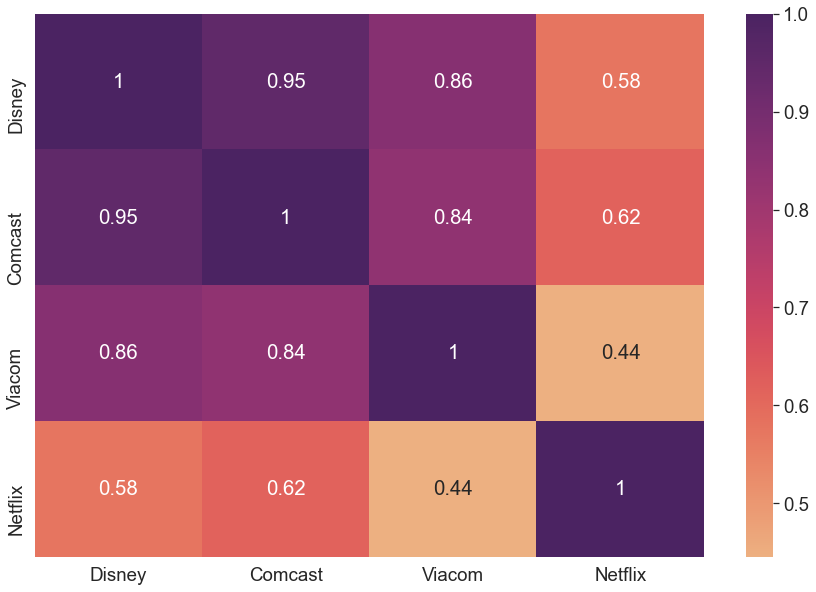

In [23]:
# 2020 to now
sns.set(rc={'figure.figsize':(15, 10)})
sns.set(font_scale=1.7)
sns.heatmap(df_close_year.corr(), annot=True, cmap='flare')
plt.show()

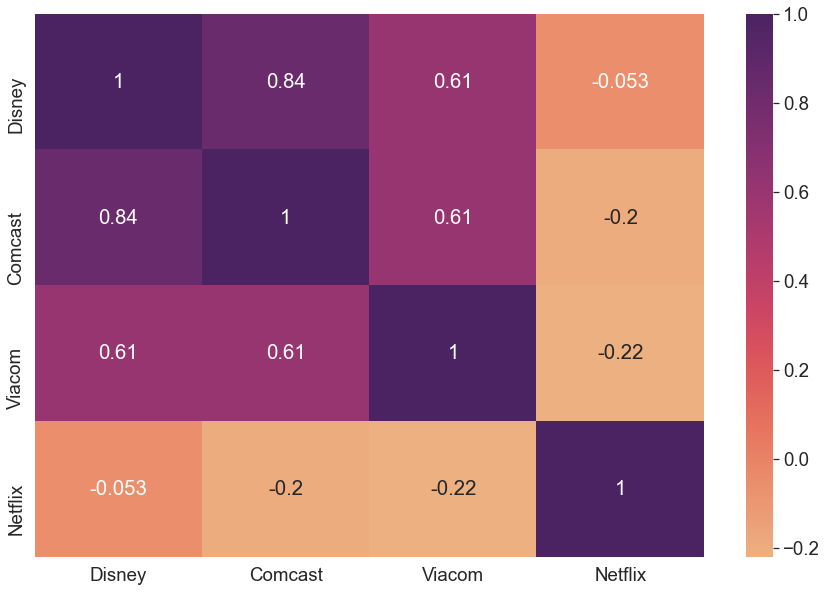

In [24]:
# 2021 to current time
sns.set(rc={'figure.figsize':(15, 10)})
sns.set(font_scale=1.7)
sns.heatmap(df_close_now.corr(), annot=True, cmap='flare')
plt.show()

## What is the risk of investing in a particular stock?

In [25]:
fig = make_subplots(rows=2, cols=2, subplot_titles=('Disney', 'Comcast', 'Viacom', 'Netflix'),  
                    x_title='Date', y_title='Dollar Volume ($)')

fig.add_trace(go.Scatter(x=disney_year.Date, y=disney_year.dollar_volume,
                         mode='lines', line=dict(color='blue')), row=1, col=1)
fig.add_hline(y=20000000, line = dict(color = 'black', width=2, dash='dash'))
              #line_width=2, line_dash='dash', line_color='crimson', row=1, col=1)


fig.add_trace(go.Scatter(x=comcast_year.Date, y=comcast_year.dollar_volume,
                         mode='lines', line=dict(color='orange')), row=1, col=2)
fig.add_hline(y=20000000, line = dict(color = 'black', width=2, dash='dash'))


fig.add_trace(go.Scatter(x=viacom_year.Date, y=viacom_year.dollar_volume,
                         mode='lines', line=dict(color='red')), row=2, col=1)
fig.add_hline(y=20000000, line = dict(color = 'black', width=2, dash='dash'))


fig.add_trace(go.Scatter(x=netflix_year.Date, y=netflix_year.dollar_volume,
                         mode='lines', line=dict(color='green')), row=2, col=2)
fig.add_hline(y=20000000, line = dict(color = 'black', width=2, dash='dash'))


fig.update_layout(title_text='Dollar Volume', height=800, width=1000, showlegend=False)
                 
fig.show()

In [26]:
# using closing price
def return_and_risk(company_close):
    returns = company_close.pct_change().dropna()
    returns_mean = returns.mean() * 100
    print('Average pecent change: {}%'.format(round(returns_mean, 2)))
    returns_risk = returns.std() * 100
    print('Standard deviation: {}%'.format(round(returns_risk, 2)))

### Disney

In [27]:
# last year
return_and_risk(disney_year.Close)

Average pecent change: 0.1%
Standard deviation: 2.85%


In [28]:
# current year
return_and_risk(disney_now.Close)

Average pecent change: 0.05%
Standard deviation: 1.87%


### Comcast

In [29]:
# last year
return_and_risk(comcast_year.Close)

Average pecent change: 0.08%
Standard deviation: 2.26%


In [30]:
# current year
return_and_risk(comcast_now.Close)

Average pecent change: 0.11%
Standard deviation: 1.58%


### Viacom

In [31]:
# last year
return_and_risk(viacom_year.Close)

Average pecent change: 0.11%
Standard deviation: 4.88%


In [32]:
# current year
return_and_risk(viacom_now.Close)

Average pecent change: 0.34%
Standard deviation: 6.0%


### Netflix

In [33]:
# last year
return_and_risk(netflix_year.Close)

Average pecent change: 0.17%
Standard deviation: 2.91%


In [34]:
# current year
return_and_risk(netflix_now.Close)

Average pecent change: 0.0%
Standard deviation: 2.91%


In [35]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=[disney_year.Close.pct_change().dropna().mean()*100],
    y=[disney_year.Close.pct_change().dropna().std()*100],
    mode="markers+text",
    marker=dict(size=30, color='blue'),
    text='Disney',
    textposition="top center"
))

fig.add_trace(go.Scatter(
    x=[comcast_year.Close.pct_change().dropna().mean()*100],
    y=[comcast_year.Close.pct_change().dropna().std()*100],
    mode="markers+text",
    marker=dict(size=30, color='orange'),
    text='Comcast',
    textposition="top center"
))
fig.add_trace(go.Scatter(
    x=[viacom_year.Close.pct_change().dropna().mean()*100],
    y=[viacom_year.Close.pct_change().dropna().std()*100],
    mode="markers+text",
    marker=dict(size=30, color='red'),
    text='Viacom',
    textposition="top center"
))
fig.add_trace(go.Scatter(
    x=[netflix_year.Close.pct_change().dropna().mean()*100],
    y=[netflix_year.Close.pct_change().dropna().std()*100],
    mode="markers+text",
    marker=dict(size=30, color='green'),
    text='Netflix',
    textposition="top center"
))

fig.update_layout(title='Previous year - 2020 to present',
                  xaxis_title='Expected return (%)',
                  yaxis_title='Risk (%)',
                  font_size=16, 
                  showlegend=False)

fig.show()


In [36]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=[disney_now.Close.pct_change().dropna().mean()*100],
    y=[disney_now.Close.pct_change().dropna().std()*100],
    mode="markers+text",
    marker=dict(size=30, color='blue'),
    text='Disney',
    textposition="top center"
))

fig.add_trace(go.Scatter(
    x=[comcast_now.Close.pct_change().dropna().mean()*100],
    y=[comcast_now.Close.pct_change().dropna().std()*100],
    mode="markers+text",
    marker=dict(size=30, color='orange'),
    text='Comcast',
    textposition="top center"
))
fig.add_trace(go.Scatter(
    x=[viacom_now.Close.pct_change().dropna().mean()*100],
    y=[viacom_now.Close.pct_change().dropna().std()*100],
    mode="markers+text",
    marker=dict(size=30, color='red'),
    text='Viacom',
    textposition="top center"
))
fig.add_trace(go.Scatter(
    x=[netflix_now.Close.pct_change().dropna().mean()*100],
    y=[netflix_now.Close.pct_change().dropna().std()*100],
    mode="markers+text",
    marker=dict(size=30, color='green'),
    text='Netflix',
    textposition="top center"
))

fig.update_layout(title='Current year',
                  xaxis_title='Expected return (%)',
                  yaxis_title='Risk (%)',
                  font_size=16,
                  showlegend=False)
fig.show()


## What is the 12-month target price for each company?

Testing for stationarity using Augmented Dickey-Fuller test. 

In [39]:
def stationarity_test(company, title):
    adfuller_test = adfuller(company['Close'],autolag='AIC')
    pval = adfuller_test[1]
    test_stat = adfuller_test[0]
    crit_values = adfuller_test[4]
# If p-value is greater than 0.05 and test statistic is greater than the critical values, 
# I can conclude the data is not stationary.
    values = []
    for value in crit_values.values():
        values.append(value)
    if (test_stat > values[0]) & (test_stat > values[1]) & (test_stat > values[2]) & (pval > 0.05): 
        print('{} stock data is not stationary.'.format(title))
    else:
        print('{} stock data is stationary.'.format(title))

In [40]:
stationarity_test(disney, 'Disney')

Disney stock data is not stationary.


In [41]:
stationarity_test(comcast, 'Comcast')

Comcast stock data is not stationary.


In [42]:
stationarity_test(viacom, 'Viacom')

Viacom stock data is not stationary.


In [43]:
stationarity_test(netflix, 'Netflix')

Netflix stock data is not stationary.


Because the data are not stationary, I will not use the Autoregressive Moving Average (ARMA) model. The Autoregressive Integrated Moving Average (ARIMA) model uses differencing to turn non-stationary data into stationary.  

### ARIMA

In [44]:
def ARIMA_model(company, title):
    training_data_len = company[(company.Date>='2015-01-01')&(company.Date<'2020-01-01')].shape[0]
    company_five = company[company.Date>='2015-01-01'] # I want five years of training data
    current = company[company.Date>='2020-01-01'].reset_index(drop=True) # This will be the test data
    data = company_five['Close'].values # I want the data in an array
    train, test = data[0:training_data_len], data[training_data_len:] # Splitting train and test data
    history = [x for x in train]
    predictions = []
    for i in range(len(test)):
        model = ARIMA(history, order=(5, 1, 0)) # order = autoregression, difference, moving average
        model_fit = model.fit() # fit the model on the test data
        output = model_fit.forecast() # record the forecasted values
        yhat = output[0] # to pick the array of forecast data only, output[1] = stderr and output[2] = conf int
        predictions.append(yhat) # combine the forcasts
        obs = test[i] 
        history.append(obs)

    rmse = math.sqrt(mean_squared_error(test, predictions)) # root mean square error
    print('Test RMSE: {}'.format(round(rmse, 3))) # print the rmse
    prediction = pd.DataFrame(predictions, columns=['Prediction'])
    current = pd.concat([current, prediction], axis=1) # adding prediction to current dataframe for plotting purposes
    
    # plot the actual versus predicted values
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=current.Date, y=current.Close,
                    mode='lines',
                    name='actual'))
    fig.add_trace(go.Scatter(x=current.Date, y=current.Prediction,
                    mode='lines',
                    name='predicted'))
    fig.update_layout(title='{}'.format(title),
                      font_size=16,
                      xaxis_title='Date',
                      yaxis_title='Closing price ($)')

    fig.show()

    
    # Forecast for the next 12-months
    forecast = model_fit.forecast(steps=365) 
    pred = forecast[0]
    year_forecast = pred[364] # forecast for 12-months from now
    ci = forecast[2] # confidence interval of predictions
    conf_int = ci[364] # the CI for 12-months from now
    print("{}'s 12-month price target: ${}".format(title, round(year_forecast, 2)))
    print('I am 95% confident the price target will be between ${} and ${}.'
          .format(round(conf_int[0], 2), round(conf_int[1], 2)))

    
    dates = pd.date_range(start='2021-04-23',end='2022-04-22') # creating future dates 
    dates = pd.DataFrame(dates, columns=['Date']) # create dataframe
    predict = pd.DataFrame(pred, columns=['Forecast']) # creat dataframe
    future = pd.concat([dates, predict], axis=1) # concatenate dataframes 
    future.to_csv('{} forecast'.format(title), sep=',', index=False)
    
    # plot the forecast
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=current.Date, y=current.Close,
                             mode='lines',
                             name='actual'))
    fig.add_trace(go.Scatter(x=future.Date, y=future.Forecast,
                             mode='lines',
                             name='forecast'))
    fig.update_layout(title='12-month Forecast',
                  xaxis_title='Date',
                  yaxis_title='Closing price ($)')
    fig.show()
    

In [45]:
ARIMA_model(disney, 'Disney')

Test RMSE: 3.557


Disney's 12-month price target: $203.57
I am 95% confident the price target will be between $134.08 and $273.07.


In [46]:
ARIMA_model(comcast, 'Comcast')

Test RMSE: 0.906


Comcast's 12-month price target: $60.57
I am 95% confident the price target will be between $42.09 and $79.05.


In [47]:
ARIMA_model(viacom, 'Viacom')

Test RMSE: 2.217


Viacom's 12-month price target: $38.94
I am 95% confident the price target will be between $-28.17 and $106.05.


In [48]:
ARIMA_model(netflix, 'Netflix')

Test RMSE: 13.142


Netflix's 12-month price target: $618.8
I am 95% confident the price target will be between $357.43 and $880.16.


### LSTM 

In [49]:
def LSTM_forecast(company, title):
    company_five = company[company.Date>='2015-01-01'] # select the last 6 years of stock prices
    data = company_five.filter(['Close']) # I want only the closing prices
    dataset = data.values # creates a numpy array of the closing prices
    training_data_len = company[(company.Date>='2015-01-01')&(company.Date<'2020-01-01')].shape[0] # Training data 
    
    scaler = MinMaxScaler(feature_range=(0,1)) # scale the data
    scaled_data = scaler.fit_transform(dataset) # scaled the entire dataset
    
    train_data = scaled_data[0: int(training_data_len), :] # I want the training data to be from 2015 to 2020
    
    # split data into train/test sets
    x_train = []
    y_train = []
    for i in range(60, train_data.shape[0]):
        x_train.append(train_data[i - 60: i, 0])
        y_train.append(train_data[i, 0])
    x_train, y_train = np.array(x_train), np.array(y_train) # convert into numpy arrays    
    x_train = np.reshape(x_train, (x_train.shape[0], x_train.shape[1], 1)) # reshape the data
    
    test_data = scaled_data[training_data_len - 60: , :]
    x_test = []
    y_test = dataset[training_data_len:, :]
    for i in range(60, len(test_data)):
        x_test.append(test_data[i-60:i, 0])
    
    x_test = np.array(x_test) # convert into numpy array
    x_test = np.reshape(x_test, (x_test.shape[0], x_test.shape[1], 1 )) # reshape the data
    
    # build LSTM model
    model = Sequential()
    model.add(LSTM(128, return_sequences=True, input_shape= (x_train.shape[1], 1)))
    model.add(LSTM(64, return_sequences=False))
    model.add(Dense(25))
    model.add(Dense(1))

    # compile the model
    model.compile(optimizer='adam', loss='mean_squared_error')

    # train the model
    model.fit(x_train, y_train, batch_size=1, epochs=5)
    #model.save('lstm_model.h5')
    # split data into test set
    
    predictions = model.predict(x_test)
    predictions = scaler.inverse_transform(predictions) # convert stock prices back from scaled values

    # calculate RMSE
    rmse = np.sqrt(np.mean(((predictions - y_test) ** 2)))
    print('RMSE: {}'.format(rmse))
    
    # plot the results
    train = company[(company.Date>='2015-01-01')&(company.Date<'2020-01-01')]
    test = company[company.Date>='2020-01-01']
    test['Forecast'] = predictions
    
    fig = go.Figure()
    #fig.add_trace(go.Scatter(x=train.Date, y=train.Close, mode='lines', name='training')) 

    fig.add_trace(go.Scatter(x=test.Date, y=test.Close, mode='lines', name='actual'))

    fig.add_trace(go.Scatter(x=test.Date, y=test.Forecast, mode='lines', name='forecast'))

    fig.update_layout(title='{} Stock Price Forecast'.format(title), xaxis_title='Date', yaxis_title='Closing Price ($)')
    
    fig.show()

In [50]:
LSTM_forecast(disney, 'Disney')


Epoch 1/5
1198/1198 [==============================] - 37s 31ms/step - loss: 0.0011
Epoch 2/5
1198/1198 [==============================] - 35s 29ms/step - loss: 5.0516e-04
Epoch 3/5
1198/1198 [==============================] - 37s 31ms/step - loss: 3.3793e-04 1s 
Epoch 4/5
1198/1198 [==============================] - 36s 30ms/step - loss: 3.2285e-04
Epoch 5/5
1198/1198 [==============================] - 38s 32ms/step - loss: 3.0093e-04
RMSE: 5.425204535349931


In [51]:
LSTM_forecast(comcast, 'Comcast')

Epoch 1/5
1198/1198 [==============================] - 38s 32ms/step - loss: 0.0013
Epoch 2/5
1198/1198 [==============================] - 38s 32ms/step - loss: 5.8723e-04
Epoch 3/5
1198/1198 [==============================] - 36s 30ms/step - loss: 6.2929e-04
Epoch 4/5
1198/1198 [==============================] - 35s 30ms/step - loss: 5.2590e-04 0s - loss: 5.2634e-0
Epoch 5/5
1198/1198 [==============================] - 35s 30ms/step - loss: 4.7310e-04
RMSE: 1.0639006530800987


In [52]:
LSTM_forecast(viacom, 'Viacom')

Epoch 1/5
1198/1198 [==============================] - 37s 31ms/step - loss: 0.0014
Epoch 2/5
1198/1198 [==============================] - 37s 31ms/step - loss: 4.6086e-04
Epoch 3/5
1198/1198 [==============================] - 37s 31ms/step - loss: 3.2692e-04
Epoch 4/5
1198/1198 [==============================] - 38s 31ms/step - loss: 2.7166e-04
Epoch 5/5
1198/1198 [==============================] - 37s 31ms/step - loss: 2.6680e-04
RMSE: 2.3564062162375983


In [53]:
LSTM_forecast(netflix, 'Netflix')

Epoch 1/5
1198/1198 [==============================] - 38s 32ms/step - loss: 0.0015
Epoch 2/5
1198/1198 [==============================] - 38s 32ms/step - loss: 6.5544e-04
Epoch 3/5
1198/1198 [==============================] - 37s 31ms/step - loss: 4.2987e-04
Epoch 4/5
1198/1198 [==============================] - 38s 32ms/step - loss: 4.0466e-04
Epoch 5/5
1198/1198 [==============================] - 37s 31ms/step - loss: 3.5850e-04
RMSE: 28.358709376929735
